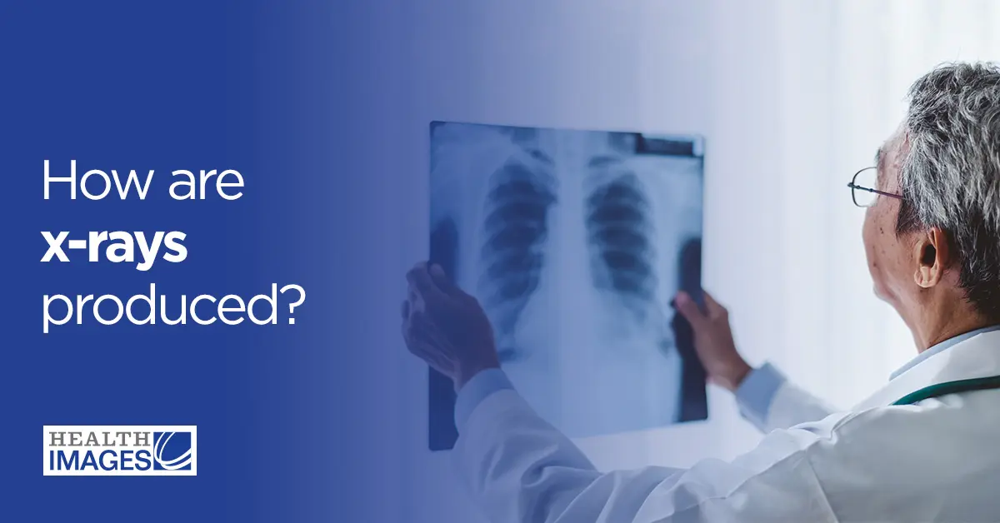

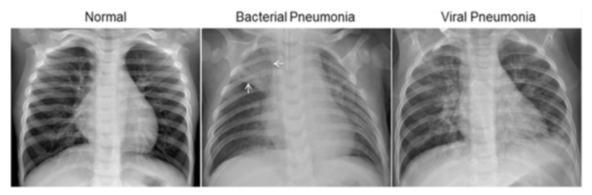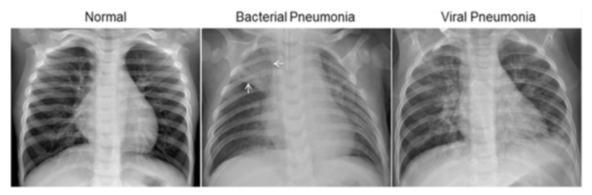

The dataset is organized into 3 folders (train, test, val) and contains subfolders for each image category (Pneumonia/Normal). There are 5,863 X-Ray images (JPEG) and 2 categories (Pneumonia/Normal).

Chest X-ray images (anterior-posterior) were selected from retrospective cohorts of pediatric patients of one to five years old from Guangzhou Women and Children’s Medical Center, Guangzhou. All chest X-ray imaging was performed as part of patients’ routine clinical care.

For the analysis of chest x-ray images, all chest radiographs were initially screened for quality control by removing all low quality or unreadable scans. The diagnoses for the images were then graded by two expert physicians before being cleared for training the AI system. In order to account for any grading errors, the evaluation set was also checked by a third expert.

In [4]:
# Import libraries for image processing, data handling, and machine learning
import cv2
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import feature
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer

# Import machine learning models
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB 
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

# Import metrics for evaluating model performance
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay

# Set seaborn theme for better plots
sns.set_theme(style="white", rc={'figure.figsize': (11.7, 8.27)})

# Ignore warnings for cleaner output
import warnings
warnings.filterwarnings('ignore')


In [5]:
def extract_hog_features(image_path):
    image = cv2.imread(image_path)
    
    # Check if the image is loaded correctly
    if image is None:
        print(f"Error loading image: {image_path}")
        return None
    
    # Resize image and convert to grayscale
    resized_image = cv2.resize(image, (128, 128))
    gray_image = cv2.cvtColor(resized_image, cv2.COLOR_BGR2GRAY)
    
    # Extract HOG features
    hog_features = feature.hog(gray_image, pixels_per_cell=(16, 16), cells_per_block=(2, 2), visualize=False)
    
    return hog_features


In [6]:
features_list = []
targets = []

# Define paths to NORMAL and PNEUMONIA image folders and their corresponding target values
folder_paths = ['C:\\Users\\user\\Desktop\\project_models\\Pneumonia-prediction\\chest_xray\\train\\NORMAL', 
                'C:\\Users\\user\\Desktop\\project_models\\Pneumonia-prediction\\chest_xray\\train\\PNEUMONIA']  
target_values = [0, 1]  # 0 for NORMAL, 1 for PNEUMONIA

# Loop through each folder and corresponding target value
for folder_path, target in zip(folder_paths, target_values):
    for filename in os.listdir(folder_path):  # Loop through each file in the folder
        if filename.endswith('.jpg') or filename.endswith('.jpeg') or filename.endswith('.png'): 
            image_path = os.path.join(folder_path, filename)  # Full path to the image
            try:
                # Extract HOG features and append to lists
                features = extract_hog_features(image_path)
                features_list.append(features)
                targets.append(target)  
            except FileNotFoundError as e:
                print(e)  # Handle file not found errors


In [7]:
def display_images_with_folder_name(folder_path):
    # Get list of image files in the folder
    images = [filename for filename in os.listdir(folder_path) 
              if filename.endswith(('.jpg', '.jpeg', '.png'))]
    
    # Display up to 5 images
    plt.figure(figsize=(15, 5))
    for i in range(min(5, len(images))):
        img_path = os.path.join(folder_path, images[i])
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB
        
        plt.subplot(1, 5, i + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(images[i])
    
    plt.suptitle(os.path.basename(folder_path))
    plt.show()


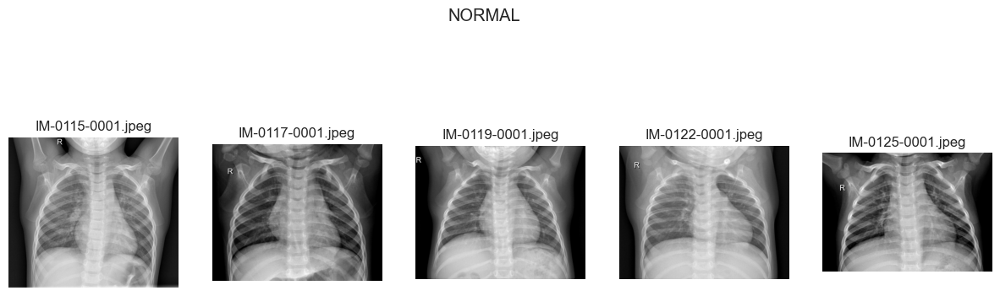

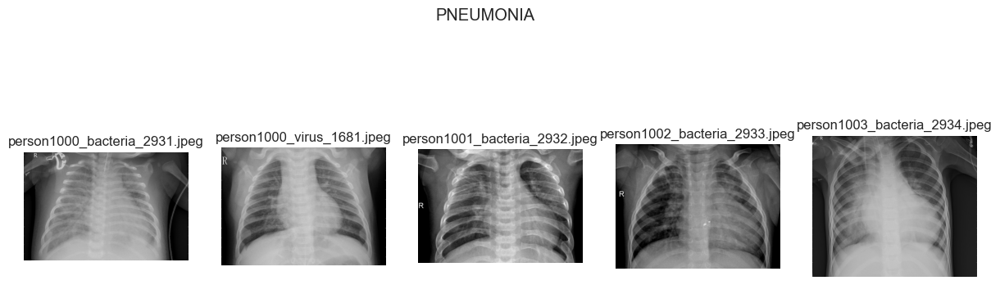

In [8]:
for folder_path in folder_paths:
   display_images_with_folder_name(folder_path)

In [9]:
def display_images_with_folder_name_gray(folder_path):
    # Get list of image files in the folder
    images = [filename for filename in os.listdir(folder_path) 
              if filename.endswith(('.jpg', '.jpeg', '.png'))]
    
    # Display up to 5 images in grayscale
    plt.figure(figsize=(15, 5))
    for i in range(min(5, len(images))):
        img_path = os.path.join(folder_path, images[i])
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convert to grayscale
        
        plt.subplot(1, 5, i + 1)
        plt.imshow(img, cmap='gray')  # Display in grayscale
        plt.axis('off')
        plt.title(images[i])
    
    plt.suptitle(os.path.basename(folder_path))
    plt.show()


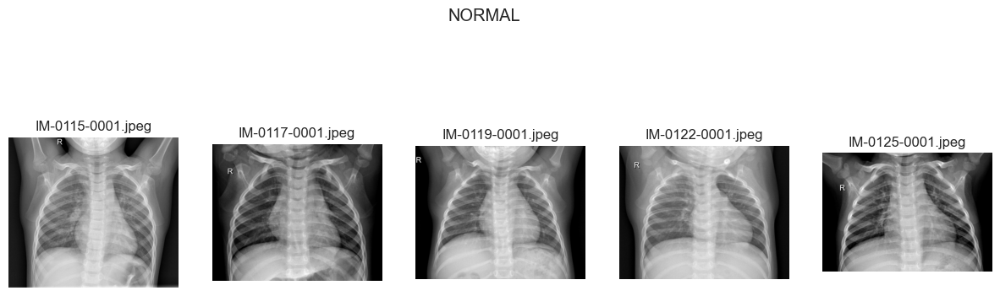

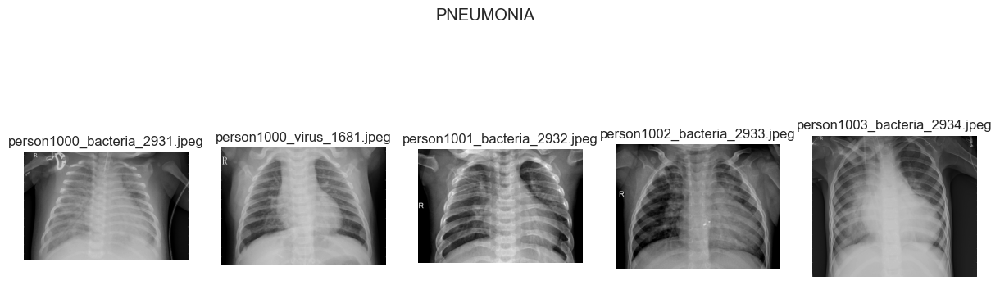

In [10]:
for folder_path in folder_paths:
   display_images_with_folder_name_gray(folder_path)

In [11]:
features_list

[array([0.29429389, 0.02845241, 0.00657385, ..., 0.03200429, 0.04979055,
        0.08854423]),
 array([0.24022157, 0.12457202, 0.09442022, ..., 0.02115703, 0.04714348,
        0.30575958]),
 array([0.27321947, 0.00306991, 0.00322139, ..., 0.0216692 , 0.09574261,
        0.31273935]),
 array([0.2964971 , 0.04686415, 0.01219856, ..., 0.00642897, 0.03229559,
        0.35243788]),
 array([0.23926238, 0.07467882, 0.08273318, ..., 0.05400263, 0.27694842,
        0.31374796]),
 array([0.29182435, 0.0445894 , 0.01356149, ..., 0.0608986 , 0.14464163,
        0.3346834 ]),
 array([0.2420816 , 0.10551777, 0.04586172, ..., 0.05887161, 0.12189307,
        0.31618874]),
 array([0.26428533, 0.05597962, 0.04694804, ..., 0.04354581, 0.05450644,
        0.33175639]),
 array([0.16854631, 0.09684846, 0.09076019, ..., 0.0889931 , 0.11929539,
        0.33308969]),
 array([0.26924954, 0.08990451, 0.05645861, ..., 0.00647324, 0.12902234,
        0.30199369]),
 array([0.14282885, 0.05375896, 0.03949751, ..., 0

In [12]:
for i, features in enumerate(features_list):
    print(f"Feature {i} shape: {features.shape}")
    if i==10:
        break


Feature 0 shape: (1764,)
Feature 1 shape: (1764,)
Feature 2 shape: (1764,)
Feature 3 shape: (1764,)
Feature 4 shape: (1764,)
Feature 5 shape: (1764,)
Feature 6 shape: (1764,)
Feature 7 shape: (1764,)
Feature 8 shape: (1764,)
Feature 9 shape: (1764,)
Feature 10 shape: (1764,)


In [13]:
X = np.array(features_list)
y = np.array(targets)
data = pd.DataFrame(X, columns=[f'feature_{i}' for i in range(1764)])
data['target'] = y

In [14]:
data.head()

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_1755,feature_1756,feature_1757,feature_1758,feature_1759,feature_1760,feature_1761,feature_1762,feature_1763,target
0,0.294294,0.028452,0.006574,0.002386,0.012093,0.006325,0.004290,0.266682,0.294294,0.294294,...,0.258298,0.106794,0.011029,0.051620,0.282798,0.012054,0.032004,0.049791,0.088544,0
1,0.240222,0.124572,0.094420,0.082042,0.065080,0.076489,0.106490,0.144469,0.185793,0.211115,...,0.305760,0.107283,0.047177,0.019794,0.012423,0.045548,0.021157,0.047143,0.305760,0
2,0.273219,0.003070,0.003221,0.001455,0.273219,0.005259,0.273219,0.273219,0.273219,0.247340,...,0.312739,0.020890,0.022433,0.007010,0.005180,0.021176,0.021669,0.095743,0.312739,0
3,0.296497,0.046864,0.012199,0.001624,0.123888,0.002626,0.021458,0.215772,0.296497,0.270177,...,0.352438,0.025191,0.011501,0.006193,0.011048,0.009445,0.006429,0.032296,0.352438,0
4,0.239262,0.074679,0.082733,0.089176,0.239262,0.239262,0.239262,0.146061,0.159631,0.087016,...,0.313748,0.081210,0.035008,0.010772,0.029546,0.046721,0.054003,0.276948,0.313748,0


In [15]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5216 entries, 0 to 5215
Columns: 1765 entries, feature_0 to target
dtypes: float64(1764), int32(1)
memory usage: 70.2 MB


In [16]:
data.describe()

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_1755,feature_1756,feature_1757,feature_1758,feature_1759,feature_1760,feature_1761,feature_1762,feature_1763,target
count,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,...,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000,5216.000000
mean,0.258514,0.118386,0.133947,0.089906,0.193694,0.084607,0.138164,0.130209,0.238321,0.201223,...,0.305854,0.053123,0.026607,0.017177,0.040606,0.023271,0.049852,0.109721,0.281273,0.742906
std,0.067143,0.084324,0.099652,0.077275,0.110854,0.073570,0.095133,0.084657,0.085345,0.081597,...,0.069820,0.054719,0.043587,0.027431,0.066830,0.031568,0.060282,0.094860,0.097142,0.437073
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.245177,0.049010,0.042504,0.024060,0.077609,0.024511,0.051624,0.059236,0.204035,0.141712,...,0.293880,0.013520,0.004136,0.000738,0.007579,0.000762,0.005514,0.026351,0.278557,0.000000
50%,0.271963,0.102031,0.116262,0.072808,0.244727,0.066658,0.124410,0.120062,0.266011,0.210561,...,0.314667,0.038334,0.012976,0.008202,0.017901,0.012248,0.027949,0.088053,0.308817,1.000000
75%,0.296984,0.174969,0.230586,0.136452,0.280937,0.125322,0.228866,0.196281,0.293929,0.266362,...,0.337085,0.073855,0.031052,0.022164,0.040600,0.034877,0.073628,0.173755,0.332309,1.000000
max,0.442849,0.351592,0.387808,0.344424,0.511526,0.390297,0.393392,0.360975,0.426825,0.577267,...,0.595320,0.403289,0.423050,0.332236,0.427484,0.297766,0.372338,0.388353,0.490360,1.000000


In [17]:
# Count missing values in each column
missing_values = data.isnull().sum()
missing_values

feature_0       0
feature_1       0
feature_2       0
feature_3       0
feature_4       0
               ..
feature_1760    0
feature_1761    0
feature_1762    0
feature_1763    0
target          0
Length: 1765, dtype: int64

In [18]:
missing_values=pd.DataFrame(missing_values,columns=["count"])
missing_values.head()

,count
feature_0,0
feature_1,0
feature_2,0
feature_3,0
feature_4,0


In [19]:
missing_values["count"].max()  # Find the maximum count of missing values in the DataFrame

0

In [20]:
#imputer=SimpleImputer(missing_values=np.nan,strategy="mean")
#for col in data.columns:
 #   data[col]=imputer.fit_transform(data[[col]] )
    

In [21]:
data.duplicated().sum()

26

In [22]:
data = data.drop_duplicates()  #Drop duplicated rows

In [23]:
corr_data=data.corr()
corr_data

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_1755,feature_1756,feature_1757,feature_1758,feature_1759,feature_1760,feature_1761,feature_1762,feature_1763,target
feature_0,1.000000,0.165374,0.093968,-0.210788,0.093963,-0.310840,-0.028201,0.041808,0.755588,0.177061,...,-0.043249,-0.104459,-0.020411,-0.051342,0.052510,-0.070359,-0.048688,-0.039711,-0.019438,0.239692
feature_1,0.165374,1.000000,0.527669,0.361558,0.237484,0.114060,-0.023138,-0.100753,0.013053,-0.161609,...,0.004351,0.027933,0.020266,-0.014505,-0.007123,-0.012847,-0.019483,0.006844,0.010091,0.247787
feature_2,0.093968,0.527669,1.000000,0.514167,0.568675,0.165580,0.160146,-0.241294,-0.028516,-0.347880,...,-0.008191,0.023856,0.101296,0.023963,0.162042,-0.043737,-0.019453,-0.060736,-0.027738,0.400237
feature_3,-0.210788,0.361558,0.514167,1.000000,0.483183,0.441042,0.079055,-0.187957,-0.255089,-0.408606,...,0.042951,0.065794,0.040147,0.008851,0.027976,-0.038578,-0.042582,-0.037983,0.013044,0.226476
feature_4,0.093963,0.237484,0.568675,0.483183,1.000000,0.405645,0.359026,-0.179948,0.045381,-0.358545,...,-0.044808,-0.014310,0.072942,0.014607,0.155979,-0.064786,-0.054982,-0.069995,-0.033086,0.443970
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
feature_1760,-0.070359,-0.012847,-0.043737,-0.038578,-0.064786,-0.000005,0.051583,0.040913,-0.081201,-0.042072,...,0.103717,0.310288,0.354518,0.484103,0.433418,1.000000,0.635423,0.476220,0.196050,-0.077682
feature_1761,-0.048688,-0.019483,-0.019453,-0.042582,-0.054982,-0.011941,0.053133,0.035019,-0.071060,-0.005729,...,0.086389,0.258843,0.302317,0.361008,0.386520,0.635423,1.000000,0.622088,0.193970,0.018004
feature_1762,-0.039711,0.006844,-0.060736,-0.037983,-0.069995,0.007120,-0.004886,0.031317,-0.063573,0.060650,...,0.232651,0.197685,0.128648,0.237726,0.113427,0.476220,0.622088,1.000000,0.420378,0.044630
feature_1763,-0.019438,0.010091,-0.027738,0.013044,-0.033086,0.031214,0.023837,0.048573,-0.021460,0.020510,...,0.721454,0.155095,0.035377,0.075696,0.006839,0.196050,0.193970,0.420378,1.000000,0.033254


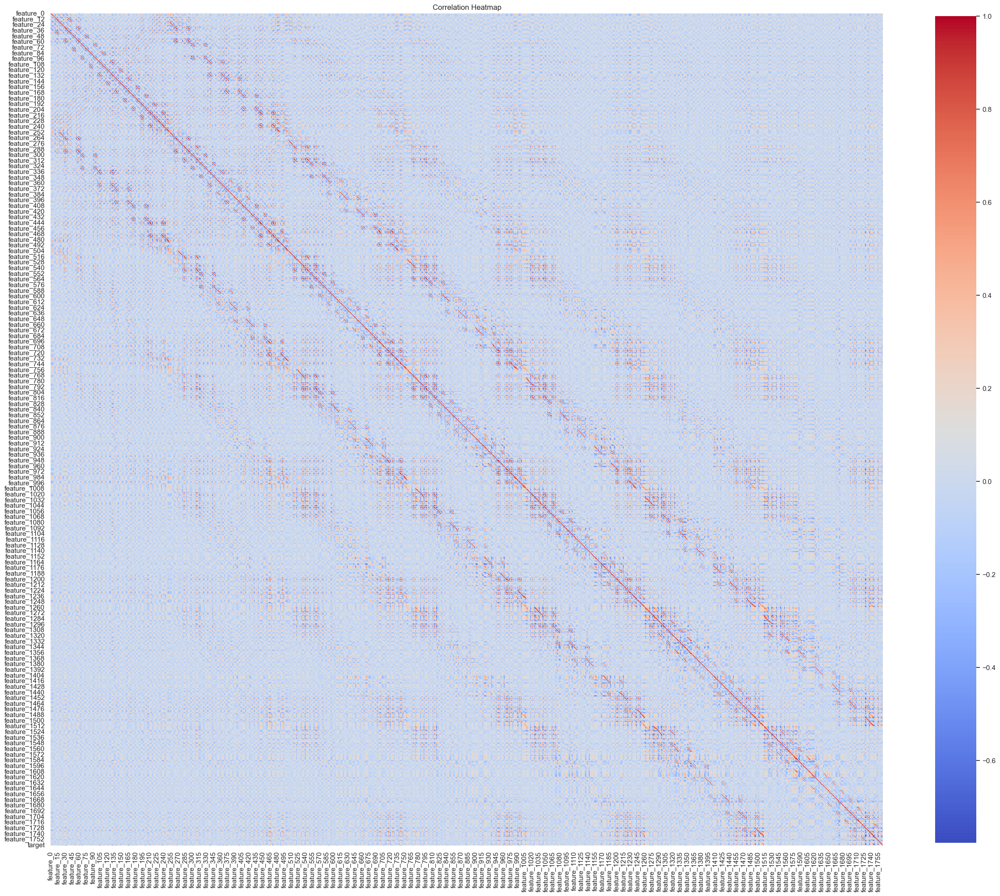

In [24]:
plt.figure(figsize=(30, 30))
sns.heatmap(corr_data, annot=False, cmap='coolwarm', fmt=".2f", square=True, cbar_kws={"shrink": .8})
plt.title('Correlation Heatmap')
plt.show()

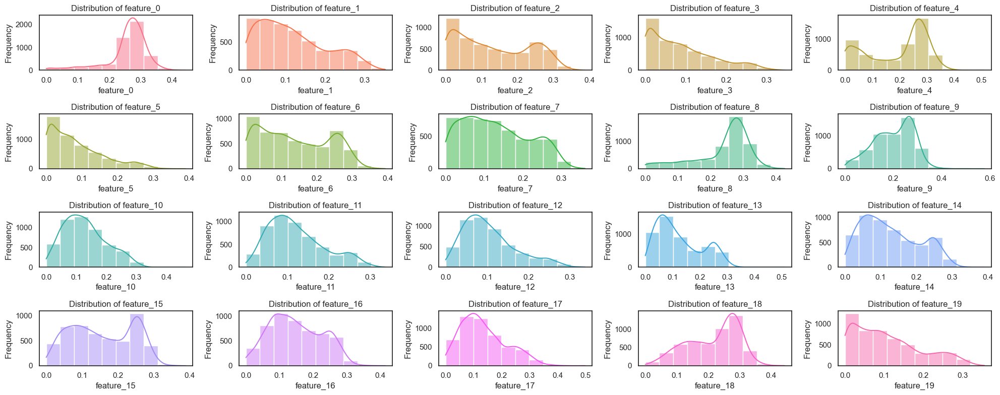

In [25]:
plt.figure(figsize=(20, 8)) 

for i in range(20):  #plot to frist 20 columns in data
    plt.subplot(4, 5, i + 1)  
    sns.histplot(data=data, x=data.columns[i], bins=10, kde=True, color=sns.color_palette("husl", 20)[i])  
    plt.title(f'Distribution of {data.columns[i]}')  
    plt.xlabel(f'{data.columns[i]}')  
    plt.ylabel('Frequency')  

plt.tight_layout()  
plt.show()  

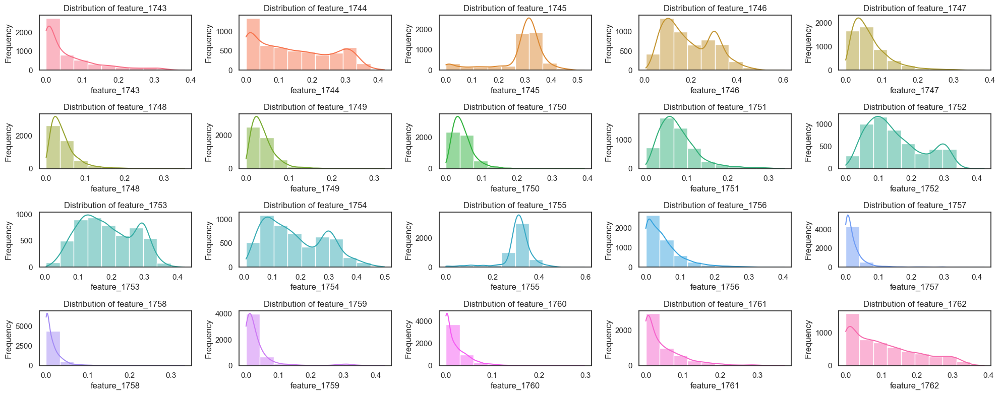

In [26]:
plt.figure(figsize=(20, 8)) 

for i in np.arange(1743, 1763):  #plot to last 20 columns in data
    plt.subplot(4, 5, i - 1742)  
    sns.histplot(data=data, x=data.columns[i], bins=10, kde=True, color=sns.color_palette("husl", 20)[i - 1743])  
    plt.title(f'Distribution of {data.columns[i]}')  
    plt.xlabel(f'{data.columns[i]}')  
    plt.ylabel('Frequency')  

plt.tight_layout()  
plt.show()  


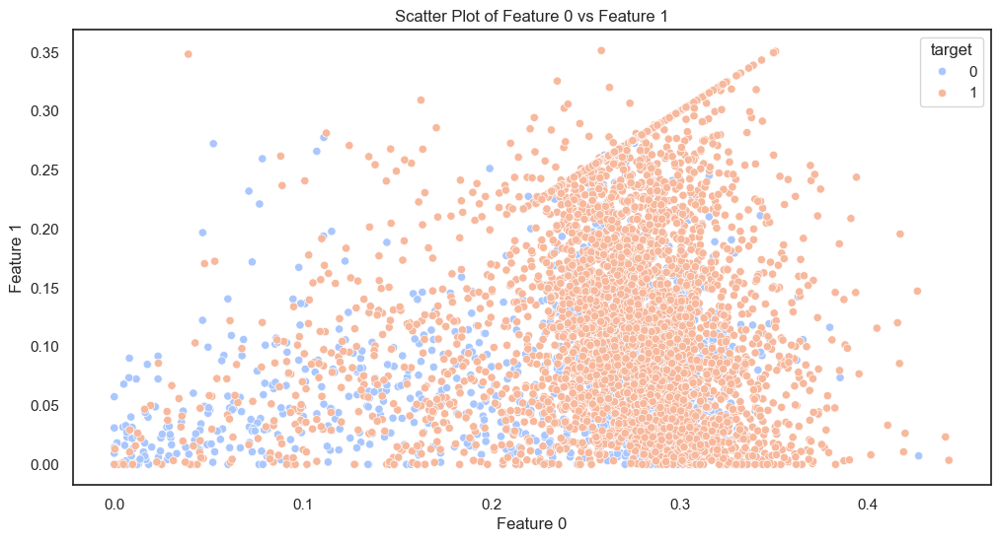

In [27]:
plt.figure(figsize=(12, 6))
sns.scatterplot(data=data, x='feature_0', y='feature_1', hue='target', palette='coolwarm')
plt.title('Scatter Plot of Feature 0 vs Feature 1')
plt.xlabel('Feature 0')
plt.ylabel('Feature 1')
plt.show()

In [28]:
features_data=data.drop(["target"],axis=1)
target_data=data["target"]

In [29]:
features_data.head(11)

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_1754,feature_1755,feature_1756,feature_1757,feature_1758,feature_1759,feature_1760,feature_1761,feature_1762,feature_1763
0,0.294294,0.028452,0.006574,0.002386,0.012093,0.006325,0.004290,0.266682,0.294294,0.294294,...,0.282798,0.258298,0.106794,0.011029,0.051620,0.282798,0.012054,0.032004,0.049791,0.088544
1,0.240222,0.124572,0.094420,0.082042,0.065080,0.076489,0.106490,0.144469,0.185793,0.211115,...,0.164265,0.305760,0.107283,0.047177,0.019794,0.012423,0.045548,0.021157,0.047143,0.305760
2,0.273219,0.003070,0.003221,0.001455,0.273219,0.005259,0.273219,0.273219,0.273219,0.247340,...,0.249369,0.312739,0.020890,0.022433,0.007010,0.005180,0.021176,0.021669,0.095743,0.312739
3,0.296497,0.046864,0.012199,0.001624,0.123888,0.002626,0.021458,0.215772,0.296497,0.270177,...,0.196549,0.352438,0.025191,0.011501,0.006193,0.011048,0.009445,0.006429,0.032296,0.352438
4,0.239262,0.074679,0.082733,0.089176,0.239262,0.239262,0.239262,0.146061,0.159631,0.087016,...,0.084962,0.313748,0.081210,0.035008,0.010772,0.029546,0.046721,0.054003,0.276948,0.313748
5,0.291824,0.044589,0.013561,0.028205,0.170088,0.140843,0.050236,0.096509,0.291824,0.202637,...,0.049689,0.334683,0.022736,0.040970,0.024916,0.042695,0.035390,0.060899,0.144642,0.334683
6,0.242082,0.105518,0.045862,0.024038,0.032661,0.024165,0.205316,0.242082,0.242082,0.242082,...,0.148832,0.316189,0.040733,0.047762,0.043162,0.039806,0.016239,0.058872,0.121893,0.316189
7,0.264285,0.055980,0.046948,0.038766,0.039367,0.038323,0.099152,0.179754,0.264285,0.264285,...,0.153350,0.331756,0.061535,0.046666,0.028029,0.025521,0.072281,0.043546,0.054506,0.331756
8,0.168546,0.096848,0.090760,0.087942,0.150162,0.128670,0.142343,0.200399,0.121887,0.180393,...,0.113190,0.333090,0.024588,0.019660,0.002278,0.006241,0.033196,0.088993,0.119295,0.333090
9,0.269250,0.089905,0.056459,0.029579,0.063647,0.035998,0.185444,0.279123,0.279123,0.226783,...,0.140572,0.301994,0.000000,0.006732,0.037527,0.024643,0.027323,0.006473,0.129022,0.301994


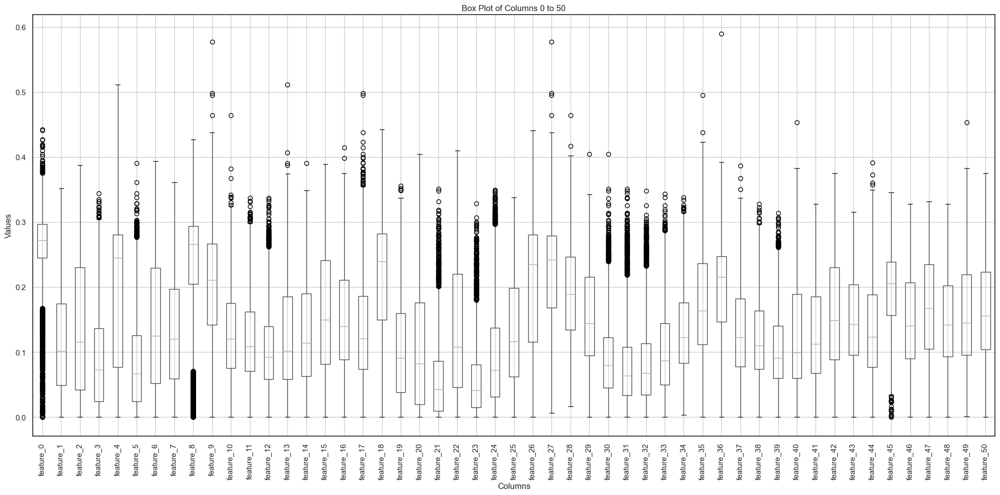

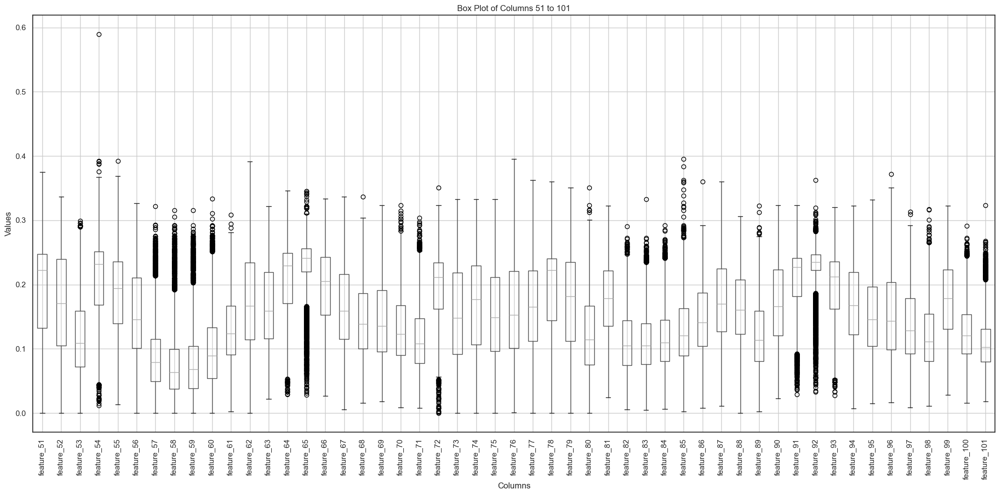

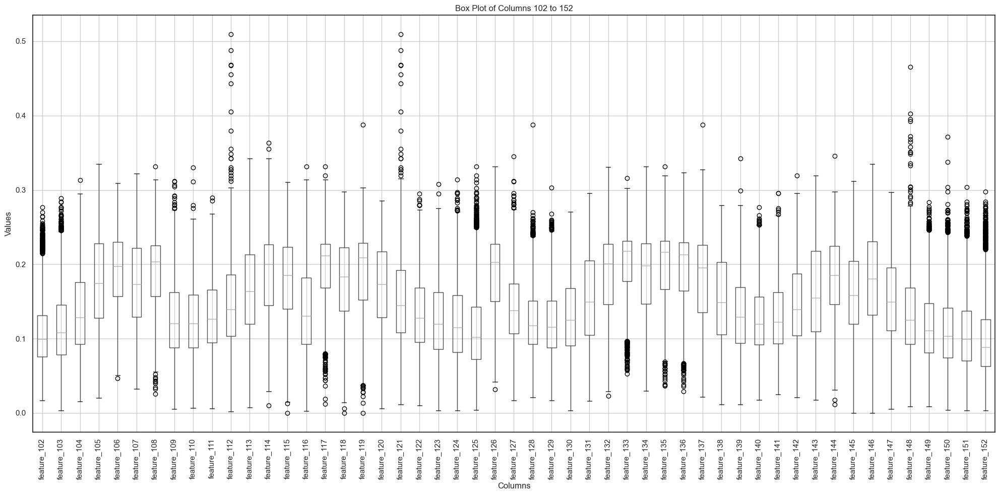

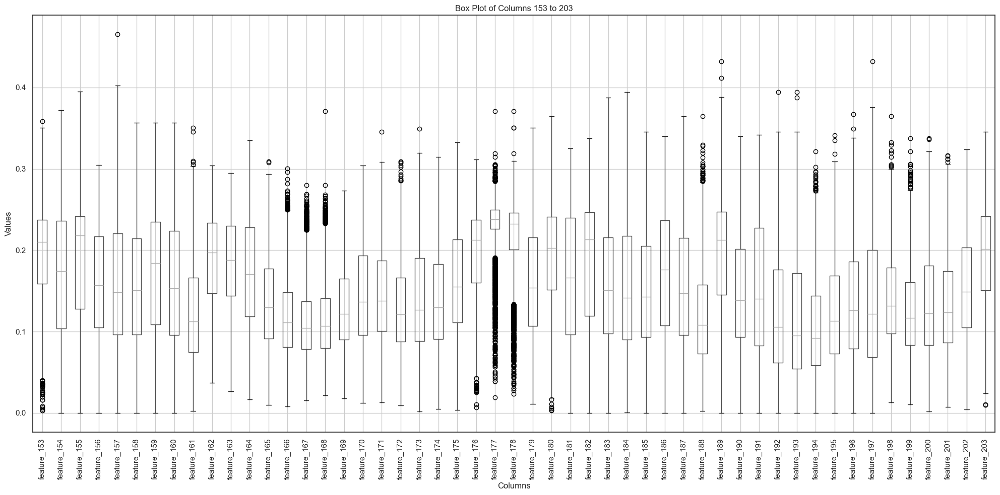

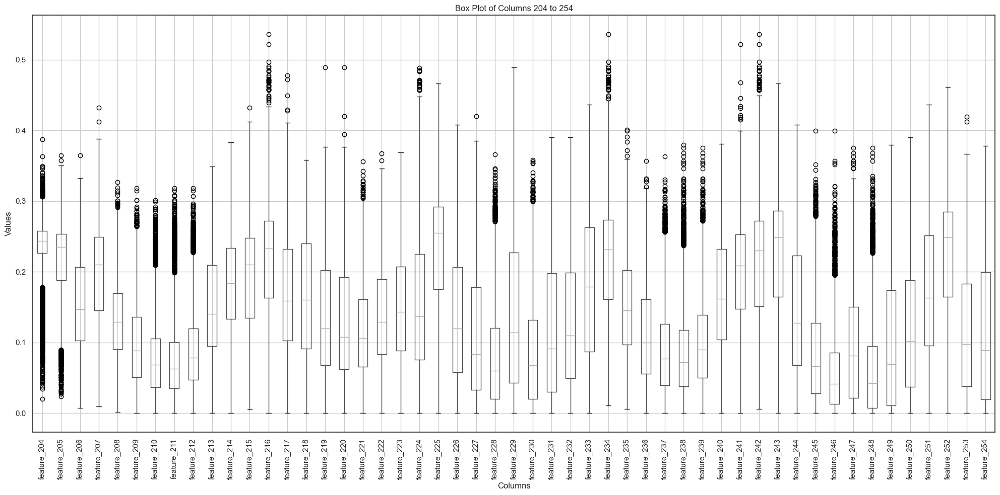

...

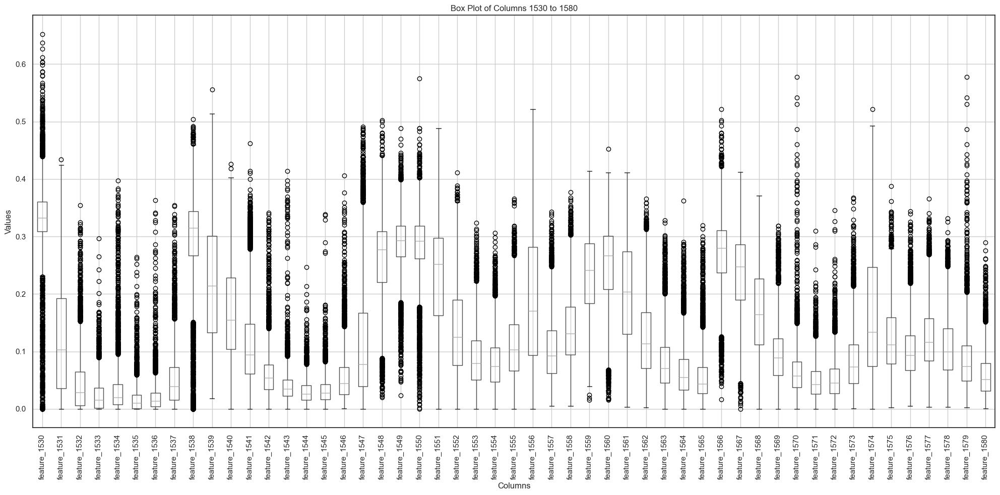

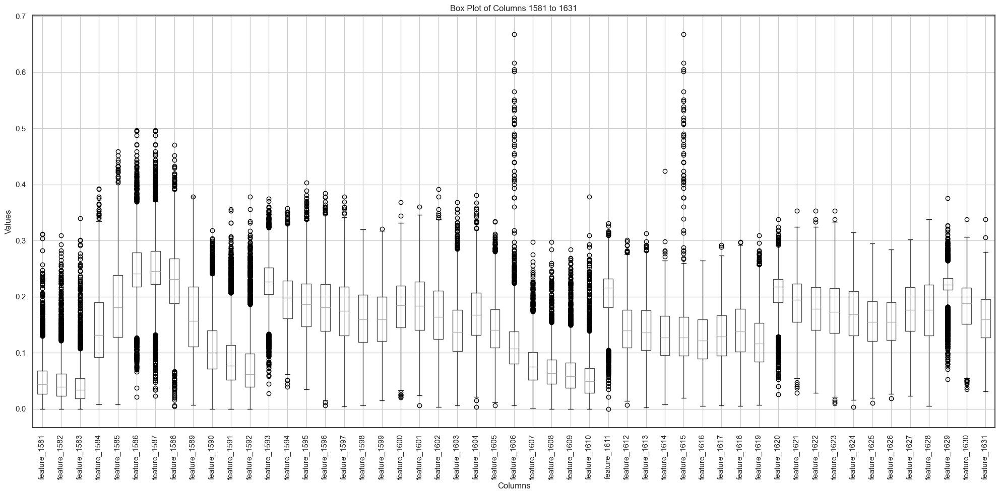

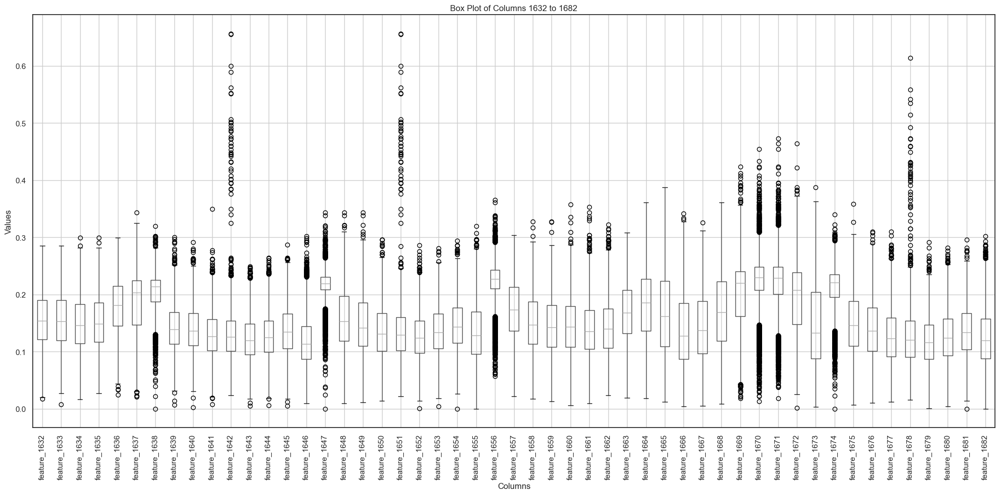

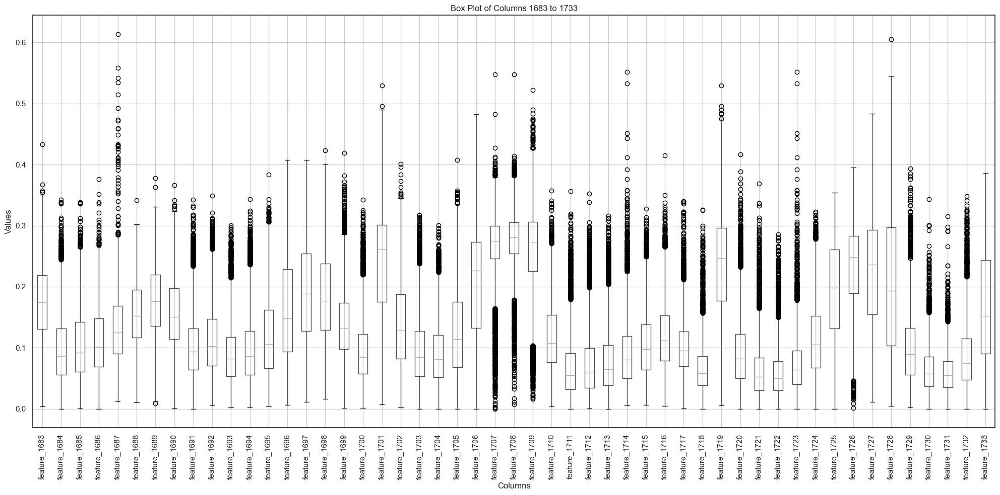

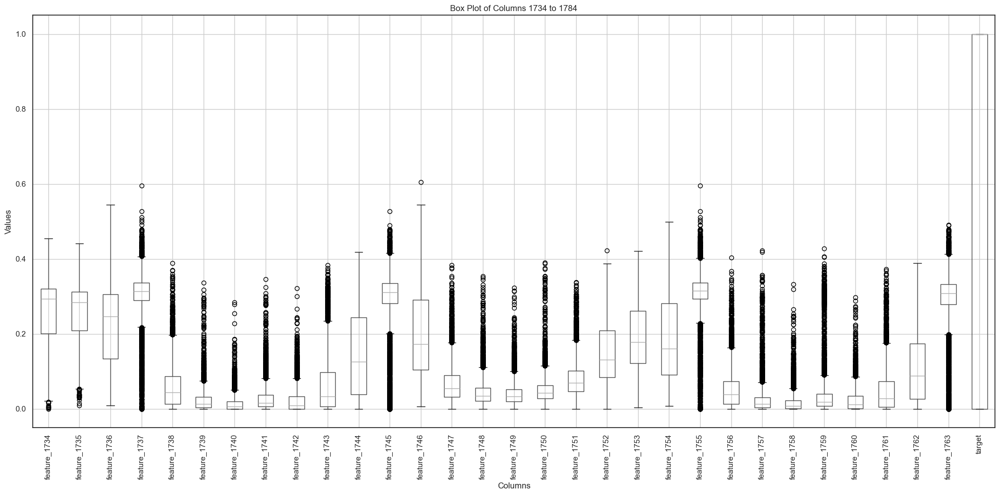

In [30]:
for i in range(0, 1764, 51):  
    plt.figure(figsize=(20, 10))  
    data_subset = data.iloc[:, i:i+51]  #boxplot to show outliners of columns
    
    data_subset.boxplot()
    
    plt.title(f'Box Plot of Columns {i} to {i+50}')
    plt.xlabel('Columns')
    plt.ylabel('Values')
    plt.xticks(rotation=90)  
    
    plt.tight_layout()  
    plt.show()

In [31]:
"""def remove_outliers(df):
    Q1 = df.quantile(0.25)  
    Q3 = df.quantile(0.75)  
    IQR = Q3 - Q1  
    
   
    df_clean = df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)]
    return df_clean
features_data= remove_outliers(features_data)"""

'def remove_outliers(df):\n    Q1 = df.quantile(0.25)  \n    Q3 = df.quantile(0.75)  \n    IQR = Q3 - Q1  \n    \n   \n    df_clean = df[~((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).any(axis=1)]\n    return df_clean\nfeatures_data= remove_outliers(features_data)'

In [32]:
def replace_outliers_with_median(df):
    for col in df.columns:
        Q1 = df[col].quantile(0.25)  # First quartile
        Q3 = df[col].quantile(0.75)  # Third quartile
        IQR = Q3 - Q1  # Interquartile range
        
        lower_bound = Q1 - 1.5 * IQR  # Lower bound
        upper_bound = Q3 + 1.5 * IQR  # Upper bound
        
        median = df[col].median()  
        
        df[col] = np.where((df[col] < lower_bound) | (df[col] > upper_bound), median, df[col])  # Replace outliers
    
    return df  

features_data = replace_outliers_with_median(features_data)  # Update features_data

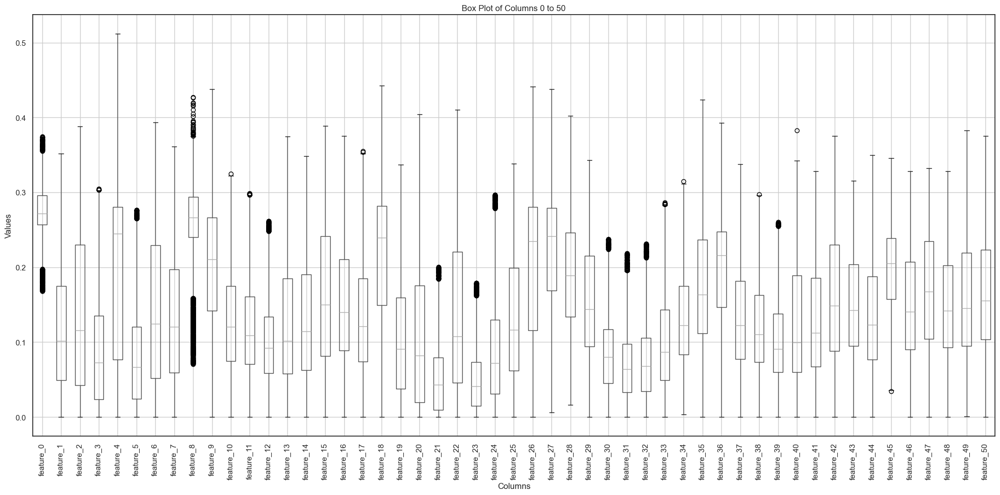

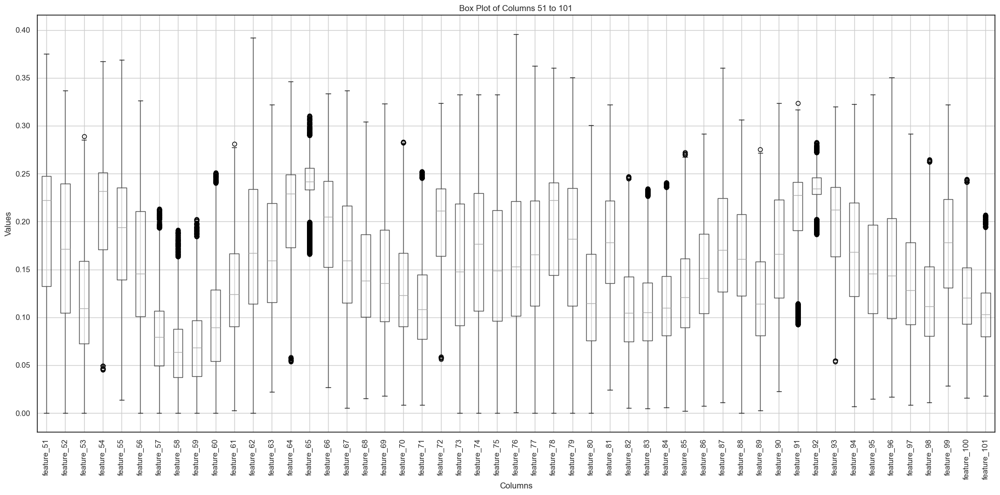

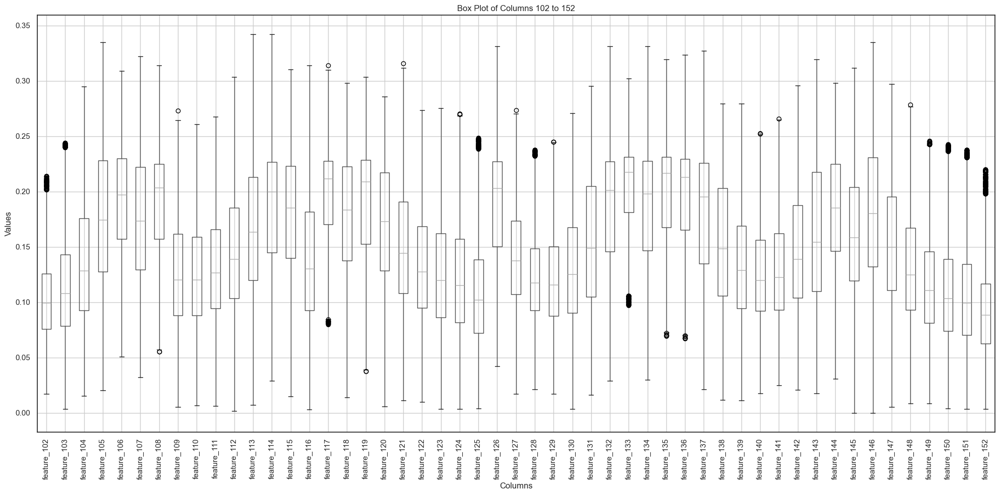

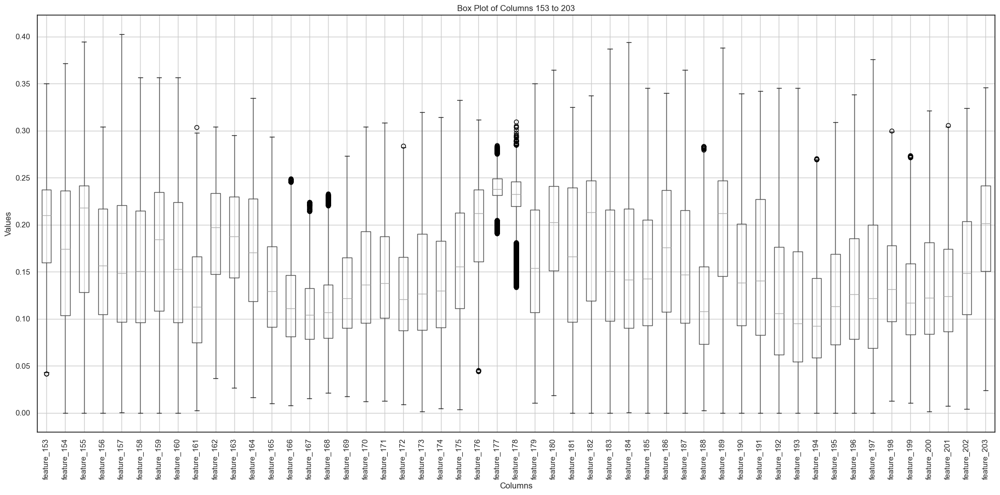

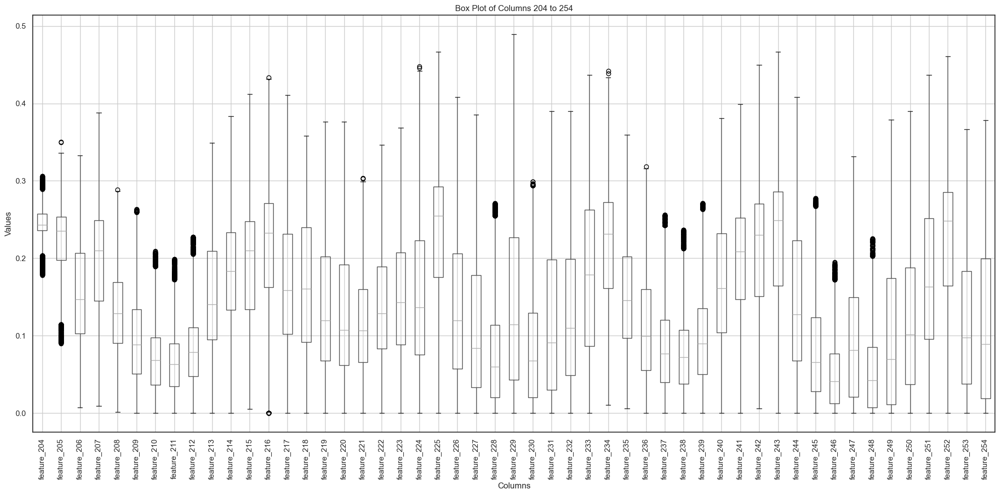

...

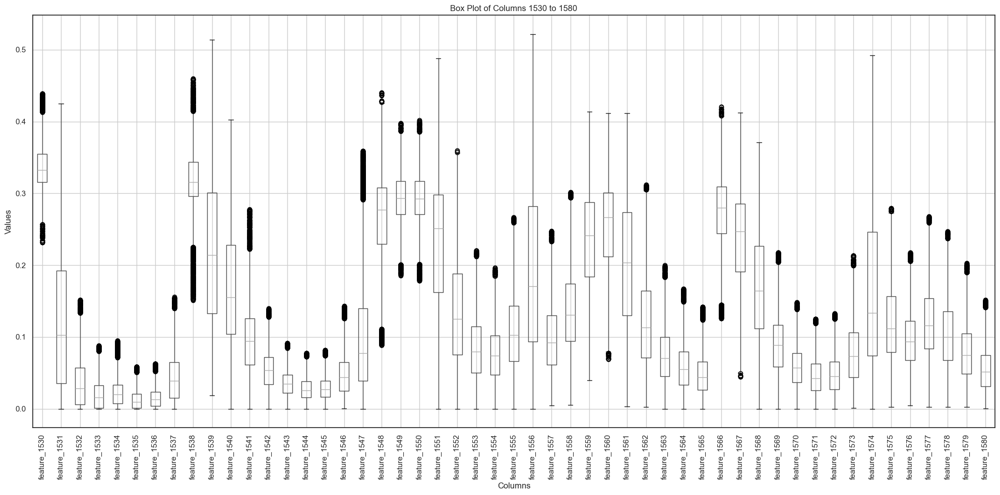

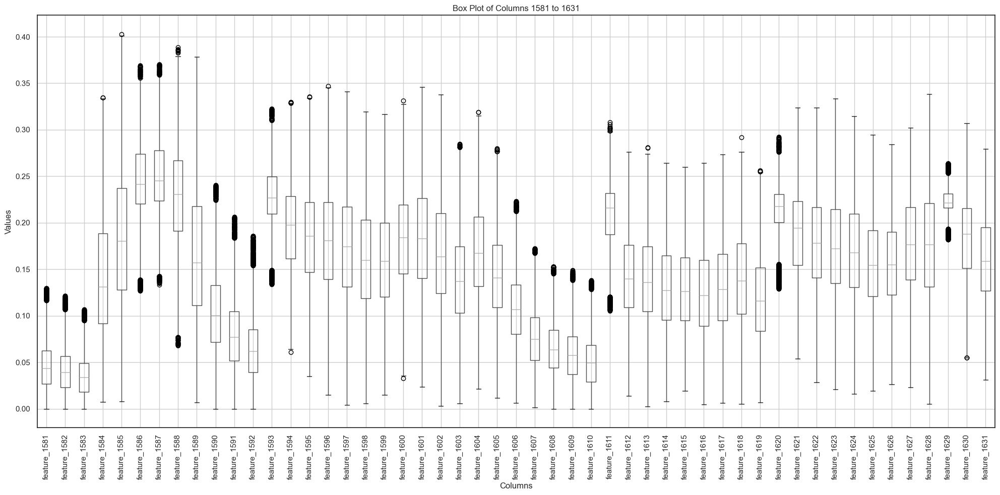

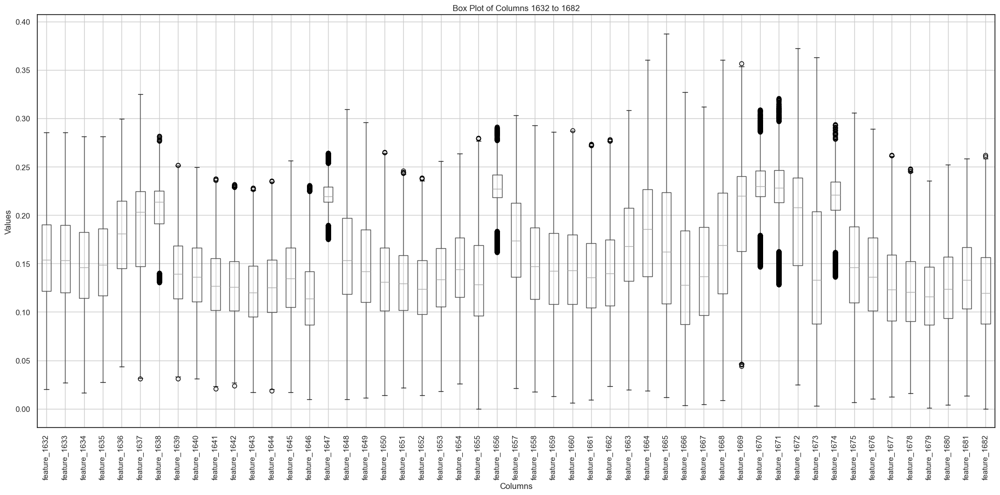

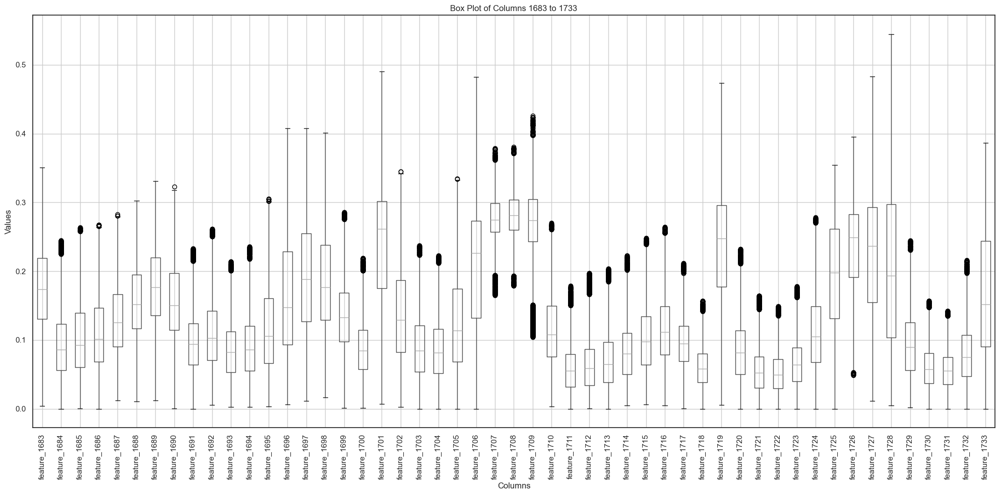

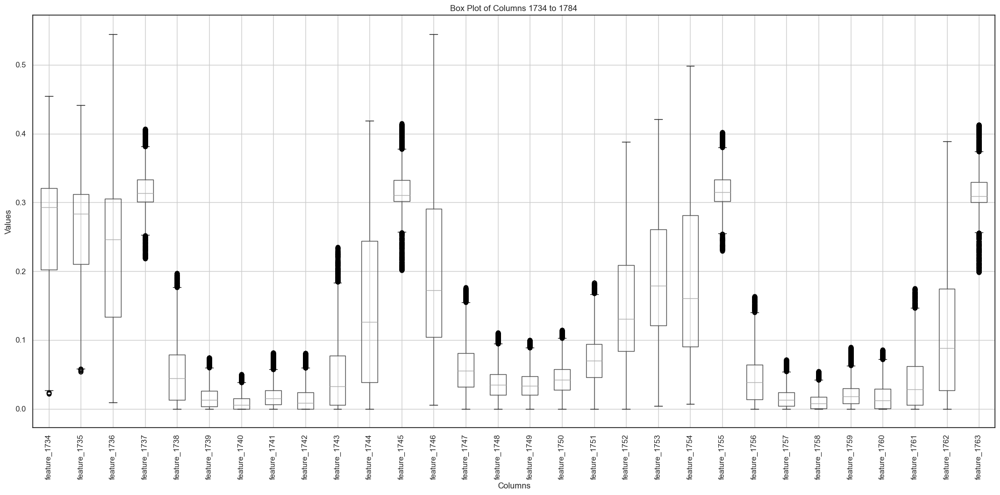

In [33]:
for i in range(0, 1763, 51):  
    plt.figure(figsize=(20, 10))  
    data_subset = features_data.iloc[:, i:i+51]   #boxplot to show outliners of columns after Update features_data
    
    data_subset.boxplot()
    
    plt.title(f'Box Plot of Columns {i} to {i+50}')
    plt.xlabel('Columns')
    plt.ylabel('Values')
    plt.xticks(rotation=90)  
    
    plt.tight_layout()  
    plt.show()

In [34]:
target_data.head()

0    0
1    0
2    0
3    0
4    0
Name: target, dtype: int32

# Split the train file dataset 

In [36]:
# Split the dataset into training and testing sets
x_train, x_test, y_train, y_test = train_test_split(features_data, target_data, test_size=0.3, random_state=42)  
# 'features_data' is the input data, 'target_data' is the labels.
# 30% of the data will be used for testing, and the rest for training.

x_train.head()  

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_1754,feature_1755,feature_1756,feature_1757,feature_1758,feature_1759,feature_1760,feature_1761,feature_1762,feature_1763
328,0.271970,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.266125,0.339634,...,0.360896,0.314686,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.308902
648,0.249086,0.082877,0.076421,0.062062,0.068306,0.084251,0.095395,0.190487,0.249086,0.249086,...,0.197263,0.295213,0.053377,0.042733,0.028344,0.023550,0.035187,0.077838,0.295213,0.295213
4828,0.284899,0.187555,0.234675,0.149405,0.284899,0.097120,0.036387,0.050925,0.284899,0.126055,...,0.306716,0.306716,0.010560,0.007883,0.000000,0.003599,0.001035,0.001388,0.020818,0.306716
898,0.293956,0.094494,0.040802,0.018495,0.015596,0.021037,0.022257,0.103299,0.293956,0.293956,...,0.214518,0.315145,0.000000,0.000000,0.000000,0.000000,0.000000,0.019341,0.000000,0.315145
2297,0.275052,0.275052,0.275052,0.069347,0.235110,0.035572,0.214953,0.070624,0.100508,0.275052,...,0.286990,0.286990,0.001331,0.000561,0.000000,0.001389,0.000000,0.000281,0.089158,0.283547


In [37]:
x_test.head()

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_1754,feature_1755,feature_1756,feature_1757,feature_1758,feature_1759,feature_1760,feature_1761,feature_1762,feature_1763
3714,0.275044,0.167123,0.087948,0.044148,0.037121,0.020723,0.128742,0.259169,0.275044,0.275044,...,0.068662,0.320560,0.072210,0.019311,0.014018,0.008173,0.049797,0.154082,0.154179,0.320560
79,0.271970,0.000605,0.004250,0.095937,0.295208,0.165559,0.033699,0.012113,0.266125,0.295208,...,0.177825,0.339297,0.050472,0.008008,0.002925,0.011704,0.003009,0.009492,0.021517,0.308902
1091,0.310403,0.090400,0.020855,0.016677,0.052415,0.039190,0.090663,0.227571,0.242599,0.098283,...,0.132343,0.321797,0.015472,0.000000,0.026656,0.017902,0.012276,0.007426,0.170304,0.321797
1664,0.249243,0.045504,0.249243,0.236517,0.249243,0.052346,0.043906,0.082365,0.249243,0.076095,...,0.135796,0.356020,0.059128,0.031520,0.033979,0.020791,0.011811,0.044108,0.073209,0.356020
4220,0.254654,0.254654,0.254654,0.104385,0.254654,0.056401,0.156025,0.176742,0.254654,0.133561,...,0.306065,0.306065,0.047874,0.006519,0.000687,0.004302,0.000000,0.001738,0.000687,0.308902


In [38]:
y_train.head()

328     0
648     0
4828    1
898     0
2297    1
Name: target, dtype: int32

# **ML Models**

# SVC

In [41]:
SVC_Model=SVC(C=1,kernel="rbf")
SVC_Model.fit(x_train,y_train)

SVC(C=1)

In [42]:
y_pred=SVC_Model.predict(x_test)
y_pred

array([1, 0, 0, ..., 1, 1, 0])

>> Elevation 

>>> Accuracy: 97.30250481695568

>>> CR by library method=
               precision    recall  f1-score   support

           0       0.95      0.95      0.95       420
           1       0.98      0.98      0.98      1137

    accuracy                           0.97      1557
   macro avg       0.97      0.96      0.97      1557
weighted avg       0.97      0.97      0.97      1557

>>> Confusion_matrix=
 [[ 397   23]
 [  19 1118]]



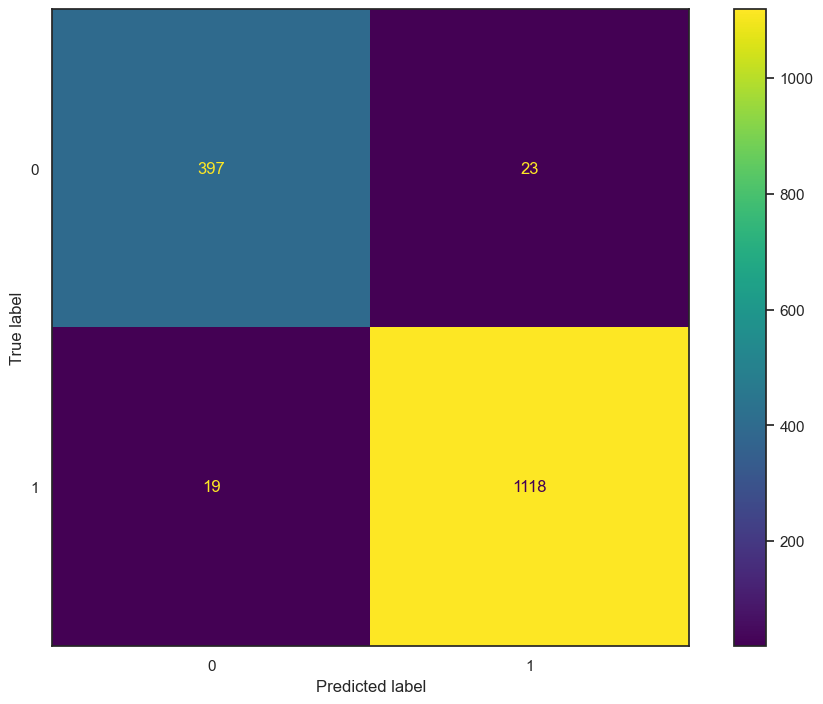

In [43]:
print(">> Elevation \n") 
accuracy_svc = accuracy_score(y_test, y_pred)*100
print(f">>> Accuracy: {accuracy_svc}\n")
print(">>> CR by library method=\n", classification_report(y_test, y_pred)) 
cm=confusion_matrix(y_test, y_pred)
print(f">>> Confusion_matrix=\n {cm}\n") 
cm_display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = [0, 1])
cm_display.plot()
plt.show()    

# KNN

In [45]:
knn_model=KNeighborsClassifier(n_neighbors=5)
knn_model.fit(x_train,y_train)

KNeighborsClassifier()

In [46]:
y_pred=SVC_Model.predict(x_test)
y_pred

array([1, 0, 0, ..., 1, 1, 0])

>> Elevation 

>>> Accuracy: 97.30250481695568

>>> CR by library method=
               precision    recall  f1-score   support

           0       0.95      0.95      0.95       420
           1       0.98      0.98      0.98      1137

    accuracy                           0.97      1557
   macro avg       0.97      0.96      0.97      1557
weighted avg       0.97      0.97      0.97      1557

>>> Confusion_matrix=
 [[ 397   23]
 [  19 1118]]



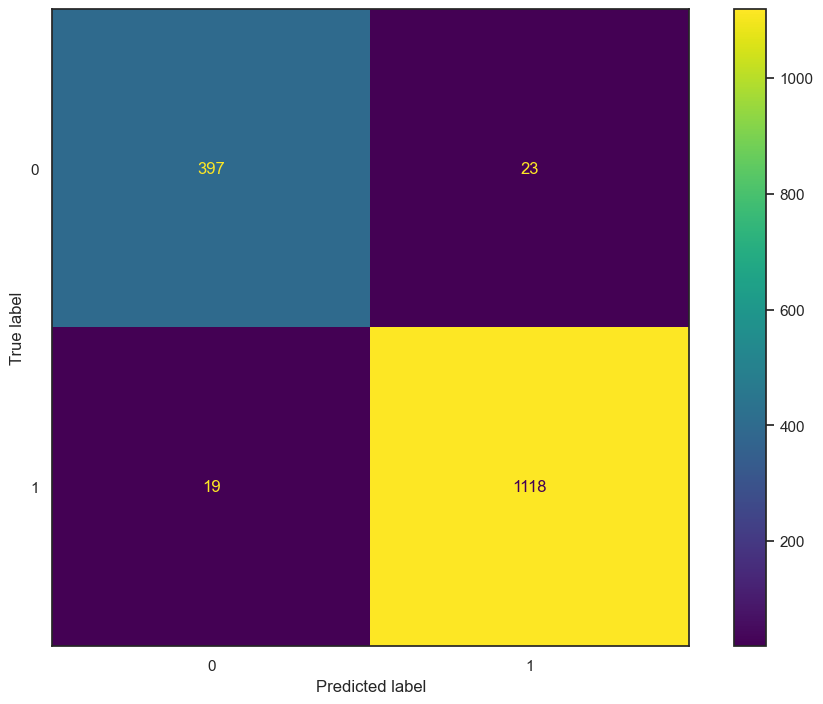

In [47]:
print(">> Elevation \n") 
accuracy_knn = accuracy_score(y_test, y_pred)*100
print(f">>> Accuracy: {accuracy_knn}\n")
print(">>> CR by library method=\n", classification_report(y_test, y_pred)) 
cm=confusion_matrix(y_test, y_pred)
print(f">>> Confusion_matrix=\n {cm}\n") 
cm_display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = [0, 1])
cm_display.plot()
plt.show()    

# DecisionTreeClassifier

In [49]:
tree_model=DecisionTreeClassifier()
param_dist = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None] + list(range(1, 11)),
    'min_samples_split': range(2, 11),
    'min_samples_leaf': range(1, 11),
    'max_features': ['auto', 'sqrt', 'log2'],
}

random_search = RandomizedSearchCV(tree_model, param_distributions=param_dist, n_iter=50, scoring='accuracy', cv=5, random_state=42)
random_search.fit(X, y)

best_model = random_search.best_estimator_

In [50]:
y_pred=best_model.predict(x_test)
y_pred

array([1, 0, 1, ..., 1, 1, 0])

>> Elevation 

>>> Accuracy: 94.7334617854849

>>> CR by library method=
               precision    recall  f1-score   support

           0       0.91      0.90      0.90       420
           1       0.96      0.97      0.96      1137

    accuracy                           0.95      1557
   macro avg       0.93      0.93      0.93      1557
weighted avg       0.95      0.95      0.95      1557

>>> Confusion_matrix=
 [[ 377   43]
 [  39 1098]]



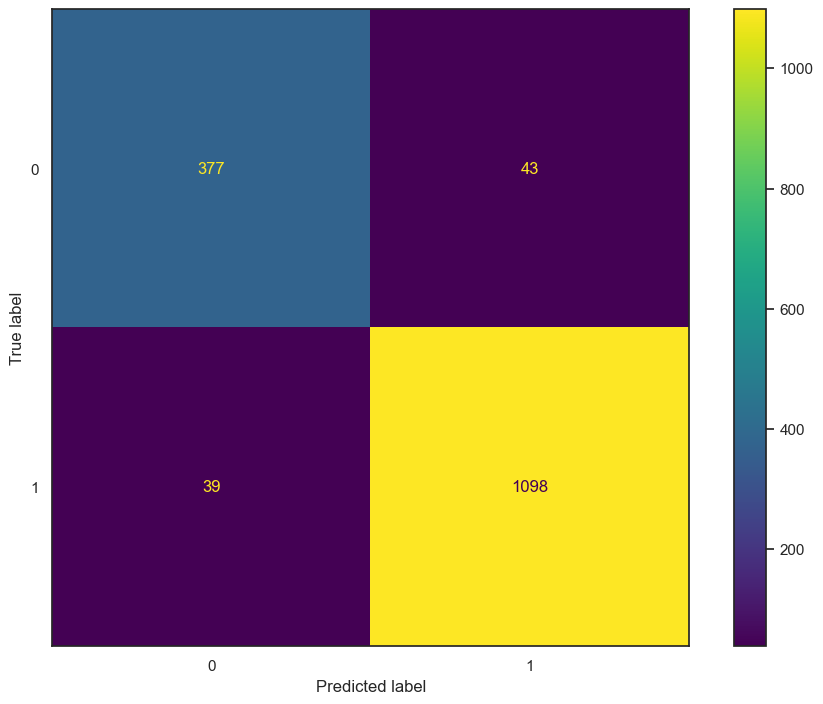

In [51]:
print(">> Elevation \n") 
accuracy_tree = accuracy_score(y_test, y_pred)*100
print(f">>> Accuracy: {accuracy_tree}\n")
print(">>> CR by library method=\n", classification_report(y_test, y_pred)) 
cm=confusion_matrix(y_test, y_pred)
print(f">>> Confusion_matrix=\n {cm}\n") 
cm_display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = [0, 1])
cm_display.plot()
plt.show()    

# RandomForestClassifier

In [53]:
rfc_model = RandomForestClassifier(n_estimators=100, criterion='gini', max_depth=50, 
                                    max_features=7)

rfc_model.fit(X, y)

RandomForestClassifier(max_depth=50, max_features=7)

In [54]:
y_pred=rfc_model.predict(x_test)
y_pred

array([1, 0, 0, ..., 1, 1, 0])

>> Elevation 

>>> Accuracy: 100.0

>>> CR by library method=
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       420
           1       1.00      1.00      1.00      1137

    accuracy                           1.00      1557
   macro avg       1.00      1.00      1.00      1557
weighted avg       1.00      1.00      1.00      1557

>>> Confusion_matrix=
 [[ 420    0]
 [   0 1137]]



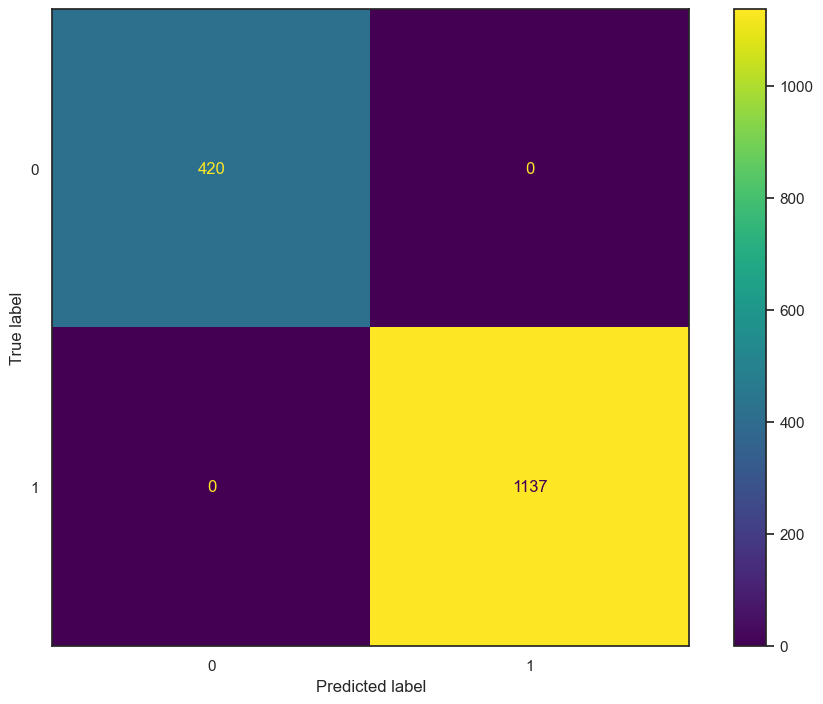

In [55]:
print(">> Elevation \n") 
accuracy_rfc= accuracy_score(y_test, y_pred)*100
print(f">>> Accuracy: {accuracy_rfc}\n")
print(">>> CR by library method=\n", classification_report(y_test, y_pred)) 
cm=confusion_matrix(y_test, y_pred)
print(f">>> Confusion_matrix=\n {cm}\n") 
cm_display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = [0, 1])
cm_display.plot()
plt.show()    

# BernoulliNB

In [57]:
NB_model=BernoulliNB()
NB_model.fit(x_train,y_train)

BernoulliNB()

In [58]:
y_pred=NB_model.predict(x_test)
y_pred

array([0, 1, 0, ..., 1, 1, 0])

>> Elevation 

>>> Accuracy: 74.43802183686576

>>> CR by library method=
               precision    recall  f1-score   support

           0       0.52      0.56      0.54       420
           1       0.83      0.81      0.82      1137

    accuracy                           0.74      1557
   macro avg       0.68      0.69      0.68      1557
weighted avg       0.75      0.74      0.75      1557

>>> Confusion_matrix=
 [[237 183]
 [215 922]]



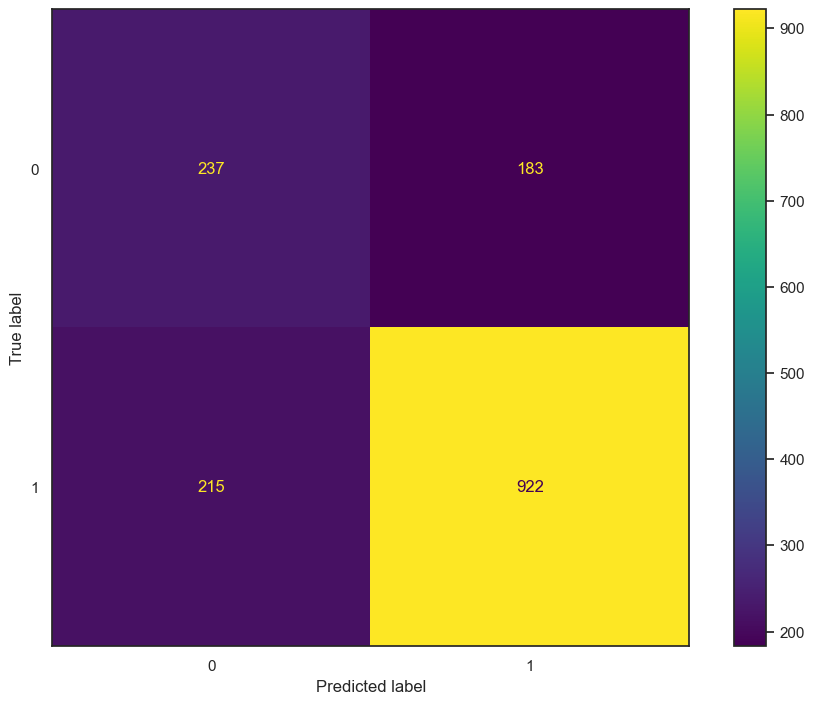

In [59]:
print(">> Elevation \n") 
accuracy_NB = accuracy_score(y_test, y_pred)*100
print(f">>> Accuracy: {accuracy_NB}\n")
print(">>> CR by library method=\n", classification_report(y_test, y_pred)) 
cm=confusion_matrix(y_test, y_pred)
print(f">>> Confusion_matrix=\n {cm}\n") 
cm_display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = [0, 1])
cm_display.plot()
plt.show()    

# XGBClassifier

In [61]:
xgb_model=XGBClassifier()
xgb_model.fit(x_train,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

y_pred=xgb_model.predict(x_test)
y_pred

>> Elevation 

>>> Accuracy: 74.43802183686576

>>> CR by library method=
               precision    recall  f1-score   support

           0       0.52      0.56      0.54       420
           1       0.83      0.81      0.82      1137

    accuracy                           0.74      1557
   macro avg       0.68      0.69      0.68      1557
weighted avg       0.75      0.74      0.75      1557

>>> Confusion_matrix=
 [[237 183]
 [215 922]]



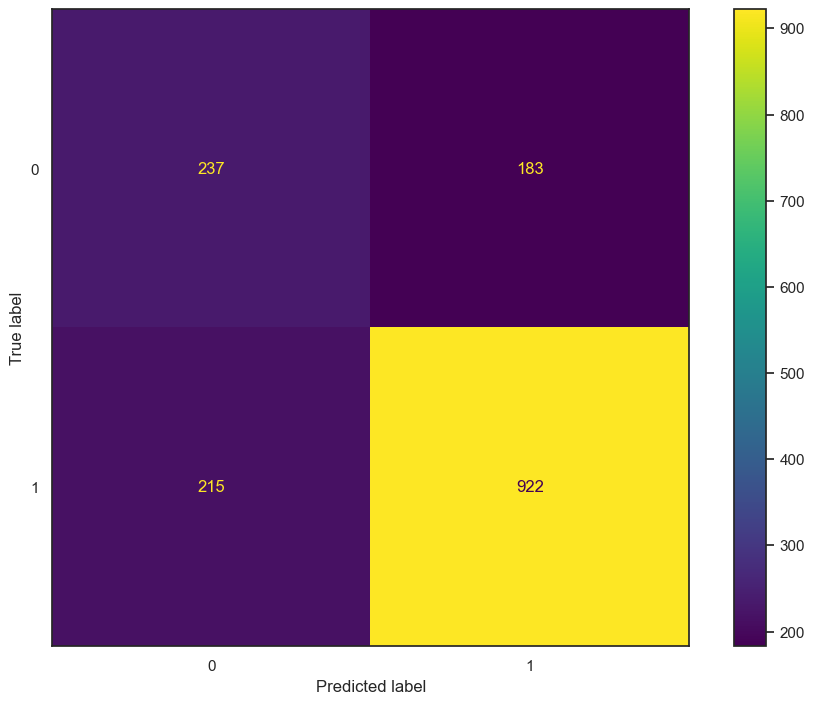

In [63]:
print(">> Elevation \n") 
accuracy_xgb = accuracy_score(y_test, y_pred)*100
print(f">>> Accuracy: {accuracy_xgb}\n")
print(">>> CR by library method=\n", classification_report(y_test, y_pred)) 
cm=confusion_matrix(y_test, y_pred)
print(f">>> Confusion_matrix=\n {cm}\n") 
cm_display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = [0, 1])
cm_display.plot()
plt.show()    

In [64]:
accuracy_tabel = {
    "SVC": accuracy_svc,
    "KNN": accuracy_knn,
    "Tree": accuracy_tree,
    "RFC": accuracy_rfc,
    "NB": accuracy_NB,
    "XGB": accuracy_xgb
}

accuracy_tabel = pd.DataFrame(list(accuracy_tabel.items()), columns=["Model", "accuracy"])
accuracy_tabel

,Model,accuracy
0,SVC,97.302505
1,KNN,97.302505
2,Tree,94.733462
3,RFC,100.000000
4,NB,74.438022
5,XGB,74.438022


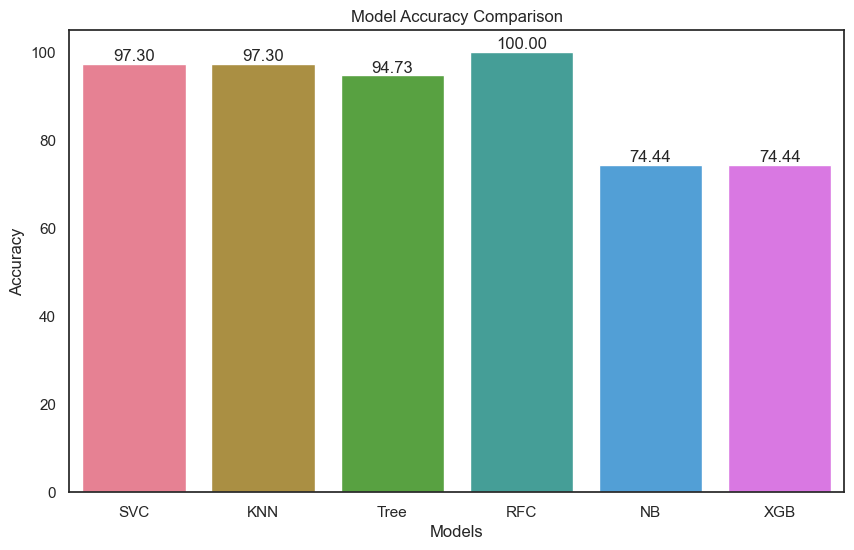

In [65]:
plt.figure(figsize=(10, 6))
bar_plot = sns.barplot(data=accuracy_tabel, x="Model", y="accuracy", palette="husl")

plt.title('Model Accuracy Comparison')
plt.xlabel('Models')
plt.ylabel('Accuracy')


for p in bar_plot.patches:
    bar_plot.annotate(f'{p.get_height():.2f}', 
                      (p.get_x() + p.get_width() / 2., p.get_height()), 
                      ha='center', va='bottom')

plt.show()

# Use file test to ensure Accuracy

In [67]:
features_list = []
targets = []

# Define paths to NORMAL and PNEUMONIA image folders and their corresponding target values
folder_paths = ['C:\\Users\\user\\Desktop\\project_models\\Pneumonia-prediction\\chest_xray\\test\\NORMAL', 
                'C:\\Users\\user\\Desktop\\project_models\\Pneumonia-prediction\\chest_xray\\test\\PNEUMONIA']  
target_values = [0, 1]  # 0 for NORMAL, 1 for PNEUMONIA

# Loop through each folder and corresponding target value
for folder_path, target in zip(folder_paths, target_values):
    for filename in os.listdir(folder_path):  # Loop through each file in the folder
        if filename.endswith('.jpg') or filename.endswith('.jpeg') or filename.endswith('.png'): 
            image_path = os.path.join(folder_path, filename)  # Full path to the image
            try:
                # Extract HOG features and append to lists
                features = extract_hog_features(image_path)
                features_list.append(features)
                targets.append(target)  
            except FileNotFoundError as e:
                print(e)  # Handle file not found errors


In [68]:
X = np.array(features_list)
y = np.array(targets)
data_test = pd.DataFrame(X, columns=[f'feature_{i}' for i in range(1764)])
data_test['target'] = y

In [69]:
data_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 624 entries, 0 to 623
Columns: 1765 entries, feature_0 to target
dtypes: float64(1764), int32(1)
memory usage: 8.4 MB


In [70]:
# Count missing values in each column
missing_values = data.isnull().sum()
missing_values

feature_0       0
feature_1       0
feature_2       0
feature_3       0
feature_4       0
               ..
feature_1760    0
feature_1761    0
feature_1762    0
feature_1763    0
target          0
Length: 1765, dtype: int64

In [71]:
data_test.duplicated().sum()

6

In [72]:
data_test=data_test.drop_duplicates()

In [73]:
data_test.duplicated().sum()

0

In [74]:
features_test=data_test.drop(["target"],axis=1)
target_test=data_test["target"]

In [75]:
# Handle outliers
features_test= replace_outliers_with_median(features_test)

In [84]:
y_traget=knn_model.predict(features_test)

>> Elevation 

>>> Accuracy: 83.1715210355987

>>> CR by library method=
               precision    recall  f1-score   support

           0       0.92      0.61      0.73       231
           1       0.80      0.97      0.88       387

    accuracy                           0.83       618
   macro avg       0.86      0.79      0.80       618
weighted avg       0.85      0.83      0.82       618

>>> Confusion_matrix=
 [[140  91]
 [ 13 374]]



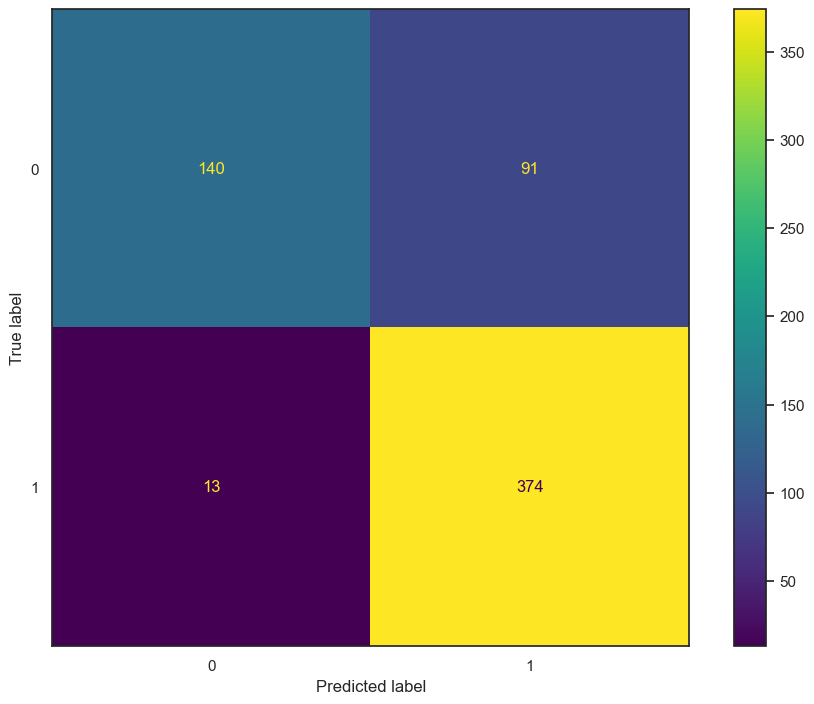

In [86]:
print(">> Elevation \n") 
accuracy_test= accuracy_score(target_test, y_traget)*100
print(f">>> Accuracy: {accuracy_test}\n")
print(">>> CR by library method=\n", classification_report(target_test, y_traget)) 
cm=confusion_matrix(target_test, y_traget)
print(f">>> Confusion_matrix=\n {cm}\n") 
cm_display = ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = [0, 1])
cm_display.plot()
plt.show()    

In [88]:
y_traget.shape

(618,)

In [90]:
data_test.shape

(618, 1765)

In [92]:
data_test["y_traget"]=y_traget
data_test

,feature_0,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,...,feature_1756,feature_1757,feature_1758,feature_1759,feature_1760,feature_1761,feature_1762,feature_1763,target,y_traget
0,0.041694,0.029867,0.115328,0.152203,0.107711,0.012344,0.014036,0.007005,0.008129,0.272692,...,0.079565,0.007748,0.003850,0.014488,0.006422,0.010624,0.052269,0.202983,0,0
1,0.266683,0.044579,0.006771,0.016261,0.019095,0.034430,0.036649,0.276287,0.298345,0.216367,...,0.051575,0.014257,0.003802,0.011746,0.007460,0.011916,0.012335,0.146379,0,0
2,0.178180,0.033045,0.020549,0.218619,0.282845,0.118856,0.176229,0.009913,0.275949,0.043029,...,0.033871,0.014162,0.005702,0.025665,0.004342,0.024403,0.061573,0.318860,0,0
3,0.115630,0.057945,0.059341,0.116938,0.257642,0.257642,0.257642,0.123116,0.073866,0.103938,...,0.047822,0.053606,0.055075,0.099569,0.067947,0.145319,0.270036,0.270036,0,0
4,0.038017,0.068862,0.238705,0.244597,0.244597,0.113064,0.099717,0.033687,0.019251,0.244597,...,0.179333,0.016851,0.025321,0.022654,0.005131,0.011733,0.031526,0.294996,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
619,0.291791,0.261386,0.291791,0.226515,0.291791,0.125116,0.291791,0.250053,0.291791,0.054565,...,0.051448,0.152139,0.000568,0.025381,0.000000,0.110659,0.018906,0.287820,1,1
620,0.190811,0.123106,0.248916,0.219482,0.248916,0.092783,0.019180,0.014415,0.223831,0.120990,...,0.099168,0.047328,0.010546,0.044917,0.006076,0.054703,0.193309,0.345673,1,1
621,0.297194,0.297194,0.297194,0.119446,0.281132,0.208900,0.297194,0.129694,0.288874,0.054033,...,0.005638,0.006339,0.000000,0.009245,0.000626,0.001981,0.000626,0.002590,1,1
622,0.275897,0.221824,0.275897,0.228543,0.185112,0.137122,0.223551,0.231425,0.275897,0.108610,...,0.010529,0.003602,0.000949,0.004669,0.000475,0.001201,0.023720,0.319963,1,1


In [102]:
#The best model is RFC_model
Model=knn_model

# Prompt the user for the image file path

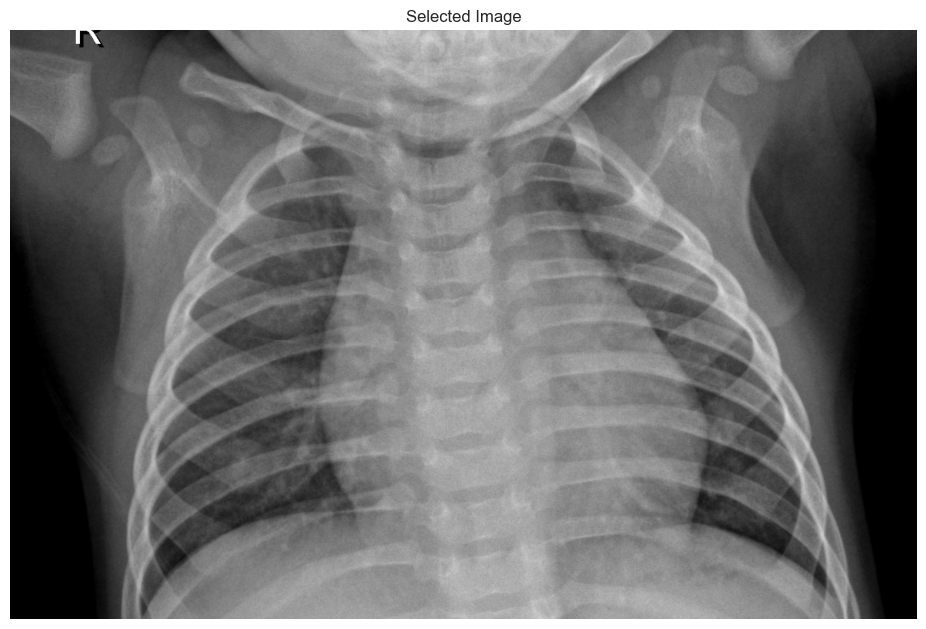

----------------------------------------------------------------------------------------------------------------------

(1, 1764)
----------------------------------------------------------------------------------------------------------------------

Pediatric patients prediction: Normal


In [104]:
# Prompt the user for the image file path
file_path = "C:\\Users\\user\\Desktop\\project_models\\Pneumonia-prediction\\chest_xray\\test\\Normal\\NORMAL2-IM-0294-0001.jpeg"

# Load the image using OpenCV
image_test = cv2.imread(file_path)

if image_test is not None:
    # Convert the image from BGR to RGB format
    image_rgb = cv2.cvtColor(image_test, cv2.COLOR_BGR2RGB)
    
    # Display the image using matplotlib
    plt.imshow(image_rgb)
    plt.axis('off')  # Hide axes
    plt.title('Selected Image')
    plt.show()
else:
    print("Error loading image. Please check the file path.")

# Extract features from the specified image
features = extract_hog_features(file_path)
features_list_1=[] #make DataFrame to features_list
features_list_1.append(features)

if features is not None:
    features_array = np.array(features_list_1)
    print("----------------------------------------------------------------------------------------------------------------------\n")
    print(features_array.shape)
    print("----------------------------------------------------------------------------------------------------------------------\n")


features_image=pd.DataFrame(features_array,columns=[f'feature_{i}' for i in range(1764)])
features_image

# Handle outliers
features_image= replace_outliers_with_median(features_image)

 # Make a prediction (Ensure 'Model' is defined and fitted)
prediction=Model.predict(features_image)
if prediction==1:
    prediction="PNEUMONIA"
else:
    prediction="Normal"
print(f"Pediatric patients prediction: {prediction}")